In [1]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [2]:
from astropy.io import fits
import matplotlib.pyplot as plt
from astropy.wcs import WCS
import numpy as np
import copy
import h5py as h5

from astropy.time import Time
import astropy.units as u


import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

from fpipe.ps.physical_gridding import *
from fpipe.ps import pwrspec_estimator
from fpipe.map import algebra as al
from fpipe.ps import find_modes
# 21cm transition frequency (in MHz)
__nu21__ = 1420.40575177

from IPython.display import display

## Scripts

In [137]:
def show_map(data_path, data_name, diff=False, freq_slice=0, axes=None, 
             figsize=(5, 5), sigma=1, vmin=None, vmax=None):

    hlist = fits.open(data_path + data_name)[0]
    
    #print(hlist.header)
    
    w = WCS(hlist.header)
    data = hlist.data
    if data.ndim == 4:
        #print(data.shape)
        data = data[0]
    
    slices = [0, ] * w.naxis
    slices[0] = 'x'
    slices[1] = 'y'
    
    if axes is None:
        fig = plt.figure(figsize=figsize)
        ax = fig.add_axes([0.1, 0.1, 0.80, 0.85], projection=w, 
                          slices=tuple(slices))
        cax = fig.add_axes([0.91, 0.2, 0.2/float(figsize[0]), 0.6])
    else:
        fig, ax, cax = axes
    
    if diff:
        _d = data[freq_slice] - data[freq_slice+1]
    else:
        #print(data.shape, data.min(), data[freq_slice].max())
        #_d = np.log10( -data[freq_slice] )
        _d = data[freq_slice]
        _d = np.ma.masked_invalid(_d)
     
    if sigma == 0:
        if vmin == None: vmin = np.ma.min(_d)
        if vmax == None: vmax = np.ma.max(_d)
    else:
        mean = np.mean(_d)
        std  = np.std(_d)
        if vmax == None: vmax = mean + sigma * std
        if vmin == None: vmin = mean - sigma * std
    #print(std)
    #print(vmin, vmax)
    im = ax.pcolormesh(_d, vmin=vmin, vmax=vmax, cmap='gist_heat')
    
    if axes is None:
        ax.set_xlabel('R.A.')
        ax.set_ylabel('Dec')
    
        fig.colorbar(im, ax=ax, cax=cax)

    return vmin, vmax, im
    
def show_map_multifreq(data_path, data_name_list, figsize=(18, 16), 
                       sigma=1, vmin=None, vmax=None, n_col = 6, label=''):

    hlist = fits.open(data_path + data_name_list[0])[0]
    #print(hlist.header)
    w = WCS(hlist.header)  
    slices = [0, ] * w.naxis
    #print(w.naxis)
    slices[0] = 'x'
    slices[1] = 'y'
    
    n_plots = len(data_name_list)
    n_row   = int(np.ceil( n_plots / float(n_col)))
    fig = plt.figure(figsize=figsize)
    gs = gridspec.GridSpec(n_row, n_col, left=0.08, bottom=0.1, top=0.9, right=0.90,
                           figure=fig, wspace=0.05, hspace=0.05)
    cax = fig.add_axes([0.91, 0.2, 0.2/float(figsize[0]), 0.6])
    
    for f in range(len(data_name_list)):
        data_name = data_name_list[f]

        #find = f * 30
    
        i = f//n_col
        j = f%n_col
    
        ax = fig.add_subplot(gs[i,j], projection=w, slices=tuple(slices), zorder=-f)
        
        vmin, vmax, im = show_map(data_path, data_name, axes=(fig, ax, cax), 
                                  sigma=sigma, vmin=vmin, vmax=vmax)
    
        lon = ax.coords[0]
        lat = ax.coords[1]
        
        lon.set_ticklabel(size=10)
        lat.set_ticklabel(size=10)
        if i != n_row-1:
            lon.set_ticklabel_visible(False)
            lon.set_axislabel('')
        else:
            ax.set_xlabel('R.A.')
            
        if j != 0:
            lat.set_ticklabel_visible(False)
            lat.set_axislabel('')
        else:
            ax.set_ylabel('Dec')

        ax.set_aspect('equal')

    fig.colorbar(im, ax=ax, cax=cax)
    cax.set_ylabel(label)
    
def combine_fits_to_cube(data_path, data_name_list, file_name, 
                         suffix='image', overwrite=True):
    
    print('Combine to a cube and convert unit from Jy/bema to mK')
    
    factor = 2 * np.sqrt(2 * np.log(2))
    with fits.open(data_path + data_name_list[0]) as hlist:
        w = WCS(hlist[0].header)#.celestial
        w = w.dropaxis(3) # drop stokes axis
        bmaj = hlist[0].header['BMAJ'] * u.deg
        bmin = hlist[0].header['BMIN'] * u.deg
        freq = hlist[0].header['CRVAL3'] * u.Hz
        omega_B = 2. * np.pi * bmaj  * bmin 
        equi =u.brightness_temperature(freq)
        Jy2K = ( 1 * u.Jy/omega_B ).to(u.K, equivalencies=equi).value
        
    print(Jy2K)
        
    
    data = []
    for data_name in data_name_list:
        print(data_name)
        with fits.open(data_path + data_name)as hlist:
            _d   = hlist[0].data[:, 0, ...]
            
            #data.append(_d * Jy2K * 1.e3)
            # bacause the input maps are in unit of mK, ignore 1.e3 factor
            data.append(_d * Jy2K )
            
        
    data = np.concatenate(data, axis=0)
    
    fits.writeto(data_path + '%s_cube-%s.fits'%(file_name, suffix), 
                 data, header=w.to_header(), overwrite=overwrite)

In [14]:
def make_kbin(kmin, kmax, knum, logk):

    if logk:
        return np.logspace(np.log10(kmin), np.log10(kmax), knum)
    else:
        return np.linspace(kmin, kmax, knum)
    
    
def svd_clean(data_all, weight=None, mode_list=[0, 5]):
    
    mode_list_ed = copy.deepcopy(mode_list)
    mode_list_st = copy.deepcopy(mode_list)
    mode_list_st[1:] = mode_list_st[:-1]
    
    # remove bad pixels
    data_all[~np.isfinite(data_all)] = 0.
    
    freq_good = np.ones(data_all.shape[0], dtype='bool')
    if weight is None:
        weight = np.ones_like(data_all)
    
    freq_cov, counts = find_modes.freq_covariance(data_all, data_all, 
                                                  weight, weight, 
                                                  freq_good, freq_good)
    svd_info = find_modes.get_freq_svd_modes(freq_cov, np.sum(freq_good))
    
    data_cleaned = []
    for (n_modes_st, n_modes_ed) in zip(mode_list_st, mode_list_ed):
        print('cleaning %d to %d modes'%(n_modes_st, n_modes_ed))
        svd_modes = svd_info[1][n_modes_st:n_modes_ed]
        data_all, amp = find_modes.subtract_frequency_modes(data_all, svd_modes, 
                                                            weight, freq_good)
        data_cleaned.append(copy.deepcopy(data_all))
        
    return data_cleaned, svd_info

def ps_est(data_all, w, weight=None, window='blackman', 
           kmin = 0.01, kmax = 1.00, knum = 30, logk = True,
           kmin_x = 0.02, kmax_x = 0.40, knum_x = 40, 
           kmin_y = 0.04, kmax_y = 0.90, knum_y = 20, 
           logk_2d = True, unitless=True):

    print('gridding map')
    cube, info = physical_grid_wcs(data_all, w, refine_frequency=1)
    Z = cube.get_axis('freq')
    X = cube.get_axis('ra')
    Y = cube.get_axis('dec')
    
    if weight is None:
        cube_w = al.ones_like(cube)
        cube_w[cube==0] = 0.
    else:
        
        cube_w, info = physical_grid_wcs(weight, w,refine_frequency=1)
    
    #print(cube.max(), cube_w.max())
    
    cube2 = cube
    cube2_w = cube_w
    
    kbin   = make_kbin(kmin,   kmax,   knum + 1,   logk   )
    kbin_x = make_kbin(kmin_x, kmax_x, knum_x + 1, logk_2d)
    kbin_y = make_kbin(kmin_y, kmax_y, knum_y + 1, logk_2d)
    
    print('ps estimation')
    ps2d, ps1d = pwrspec_estimator.calculate_xspec(cube, cube2,
                                                   cube_w, cube2_w,
                                                   window = window,
                                                   bins = kbin,
                                                   bins_x = kbin_x,
                                                   bins_y = kbin_y,
                                                   logbins = logk,
                                                   logbins_2d = logk_2d,
                                                   unitless = unitless,
                                                   nonorm=False
                                                   )
    return ps2d, ps1d

In [91]:
def fgclean_and_psest(data_path, data_name, mode_list, mask_edges=None, output_path=None):
    with fits.open(data_path + data_name) as hlist:
        print('load data from \n %s'%data_name)
        w = WCS(hlist[0].header)
        data_all = hlist[0].data

    weight = np.ones(data_all.shape)
    if mask_edges != None:
        print('mask edges %d'%mask_edges)
        weight[:, 0:mask_edges, :] = 0
        weight[:, -mask_edges:, :] = 0
        weight[:, :, 0:mask_edges] = 0
        weight[:, :, -mask_edges:] = 0
    data_all[weight==0] = 0
    data_cleaned, svd_info = svd_clean(data_all, weight=weight, mode_list=mode_list)
    ps2d_list = []
    ps1d_list = []

    for d in data_cleaned:
        mask = ~np.isfinite(d)
        d[mask] = 0.
        _weight = weight.copy()
        _weight[mask] = 0
        ps2d, ps1d = ps_est(d, w, weight=_weight)
        ps2d_list.append(ps2d)
        ps1d_list.append(ps1d)
    
    if output_path is not None:
        with h5.File(output_path, 'w') as results:
            results['head'] = w.to_header_string()
            results['data'] = data_cleaned
            for ii, m in enumerate(mode_list):
                for key in ps2d_list[ii].keys():
                    results['sub%02d/ps2d_%s'%(m, key)] = ps2d_list[ii][key]
                for key in ps1d_list[ii].keys():
                    results['sub%02d/ps1d_%s'%(m, key)] = ps1d_list[ii][key]
            
            results['svd_eigval']  = svd_info[0]
            results['svd_eigvec_l'] = np.array(svd_info[1])
            results['svd_eigvec_r'] = np.array(svd_info[2])
            results['svd_modes'] = np.array(mode_list)
    else:
        results = {}
        results['head'] = w.to_header_string()
        results['data'] = data_cleaned
        for ii, m in enumerate(mode_list):
            for key in ps2d_list[ii].keys():
                results['sub%02d/ps2d_%s'%(m, key)] = ps2d_list[ii][key]
            for key in ps1d_list[ii].keys():
                results['sub%02d/ps1d_%s'%(m, key)] = ps1d_list[ii][key]
            
        results['svd_eigval']  = svd_info[0]
        results['svd_eigvec_l'] = np.array(svd_info[1])
        results['svd_eigvec_r'] = np.array(svd_info[2])
        results['svd_modes'] = np.array(mode_list)
        return results

In [27]:
def plot_svdmaps(results, figsize=(30, 5)):
    w = results['head']
    data_cleaned = results['data']
    
    
    n_plots = len(data_cleaned)
    n_col   = n_plots
    n_row   = 1 #int(np.ceil( n_plots / float(n_col)))
    fig = plt.figure(figsize=figsize)
    gs = gridspec.GridSpec(n_row, n_col, left=0.08, bottom=0.1, top=0.8, right=0.90,
                           figure=fig, wspace=0.05, hspace=0.05)
    #cax = fig.add_axes([0.91, 0.2, 0.2/float(figsize[0]), 0.6])
    for i, d in enumerate(data_cleaned):

        factor = 1.
    
        slices = [0, ] * w.naxis
        slices[0] = 'x'
        slices[1] = 'y'

        ax = fig.add_subplot(gs[0,i], projection=w, slices=tuple(slices))
        pos = ax.get_position()
        pos.y0 = pos.y1 + 0.02
        pos.y1 = pos.y0 + 0.03
        pos.x0 = pos.x0 + 0.01
        pos.x1 = pos.x1 - 0.01
        #print(pos)
        cax = fig.add_axes(pos)
        #ax = fig.add_axes([0.1, 0.1, 0.80, 0.85], projection=w, slices=tuple(slices))
        #cax = fig.add_axes([0.91, 0.2, 0.2/float(figsize[0]), 0.6])
        
        mean = np.mean(d)
        std  = np.std(np.mean(d, axis=0))
        vmin = mean - 6 * std
        vmax = mean + 6 * std
    
        im = ax.pcolormesh(np.mean(d, axis=0) * factor, 
                           vmin=vmin, vmax=vmax, cmap='gist_heat')
        
        lon = ax.coords[0]
        lat = ax.coords[1]
        
        lon.set_ticklabel(size=10)
        lat.set_ticklabel(size=10)

        ax.set_xlabel('R.A.')
            
        if i != 0:
            lat.set_ticklabel_visible(False)
            lat.set_axislabel('')
        else:
            ax.set_ylabel('Dec')
        
        ax.set_aspect('equal')
        fig.colorbar(im, ax=ax, cax=cax, orientation="horizontal")
        cax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)

In [139]:
def plot_ps(result_list, title_list=None, mode_list = [0, 5, 10, 15, 20, 25, 30], 
            ymin=None, ymax=None, xmin=None, xmax=None, figsize=(8, 6)):
    
    # load input ps
    result_path = '/home/DATA/ycli/ska_challenge/2023/ps_results/'
    result_name = 'lightcones_brightness_xy600_z90.h5'
    with h5.File(result_path + result_name, 'r') as fp:
        #print(fp.keys())
        eor_kbin = fp['kbin'][:]
        eor_ps1d = fp['ps1d'][:]
    
    
    n_col = len(result_list)

    fig = plt.figure(figsize=figsize)
    gs = gridspec.GridSpec(1, n_col, left=0.08, bottom=0.1, top=0.9, right=0.95,
                           figure=fig, wspace=0.05, hspace=0.05)
    for i in range(n_col):
        ax = fig.add_subplot(gs[0,i])
        with h5.File(result_list[i], 'r') as f:
            #print(f.keys())
            mode_list = f['svd_modes'][:]
            
            for m, mode in enumerate(mode_list):
            
                xx = f['sub%02d/ps1d_bin_center'%mode][:]
                yy = f['sub%02d/ps1d_binavg'%mode][:]
                ax.plot(xx, yy, 'o-', label = 'Sub. %02d'%mode)

        ax.plot(eor_kbin, np.mean(eor_ps1d, axis=0), 'k.-')
        ax.loglog()
        
        if i != 0:
            ax.set_yticklabels([])
        else:
            ax.legend()
            ax.set_ylabel(r'$\Delta^2(k)\,[{\rm mK}^2]$')
        ax.set_xlabel(r'$k\,[{\rm Mpc}^{-1}h]$')
        ax.set_ylim(ymin, ymax)
        ax.set_xlim(xmin, xmax)
        if title_list != None:
            ax.set_title(title_list[i])
            
def plot_svdvalue(result_list, title_list=None, mode_list = [0, 5, 10, 15, 20, 25, 30], 
            ymin=None, ymax=None, xmin=None, xmax=None, figsize=(8, 6)):

    fig = plt.figure(figsize=figsize)
    gs = gridspec.GridSpec(1, 1, left=0.08, bottom=0.1, top=0.9, right=0.95,
                           figure=fig, wspace=0.05, hspace=0.05)
    ax = fig.add_subplot(gs[0,0])
    for i in range(len(result_list)):
        _r = result_list[i]['svd'][0]
        _x = np.arange(1, _r.shape[0]+1)
        if title_list != None:
            label=title_list[i]
        else:
            label='%02d'%i
        ax.plot(_x, _r, 'o-', label = label)

    ax.legend()
    ax.set_ylabel('SVD values')
    ax.set_xlabel('Mode NO.')
    ax.semilogy()

## Test with fine frequency resolution and narrow frequency band width

### Combine frequency slices into a cube file.

In [128]:
freq = np.arange(105.95, 117.10, 0.10)[:64]

In [138]:
data_path = '/home/ycli/data/ska_challenge/oskar_sim/wsclean_output/'
#file_name = 'FG_HI_PSshuffle_00_uw'
file_name = 'imap00_HI_PS_FG_uw_multiscale'
suffix = 'image' #'dirty' #'image'
data_name_list = ['%s/Freq%.2fMHz-%s.fits'%(file_name, ff, suffix) 
                  for ff in freq ]
#print(data_name_list)
combine_fits_to_cube(data_path, data_name_list, file_name, suffix=suffix)

Combine to a cube and convert unit from Jy/bema to mK
5111.967878275629
imap00_HI_PS_FG_uw_multiscale/Freq105.95MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq106.05MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq106.15MHz-image.fits


imap00_HI_PS_FG_uw_multiscale/Freq106.25MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq106.35MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq106.45MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq106.55MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq106.65MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq106.75MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq106.85MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq106.95MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.05MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.15MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.25MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.35MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.45MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.55MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.65MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.75MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.85MHz-image.fits
imap00_HI_PS_FG_uw_multiscale/Freq107.95MHz-image.fits
imap00_HI_

### Foreground clean and power spectrum estimation

In [140]:
data_path = '/home/ycli/data/ska_challenge/oskar_sim/wsclean_output/'
file_name = 'imap00_HI_PS_FG_uw_multiscale'
suffix = 'image'
data_name = '%s_cube-%s.fits'%(file_name, suffix)
#mode_list = [0, 5, 10, 15, 20, 25, 30]
mode_list = [0, 30]
output_path = data_path + '%s_fgps-%s.h5'%(file_name, suffix)
fgclean_and_psest(data_path, data_name, mode_list, output_path=output_path)

load data from 
 imap00_HI_PS_FG_uw_multiscale_cube-image.fits
cleaning 0 to 0 modes
cleaning 0 to 30 modes
gridding map
ps estimation
gridding map
ps estimation


### Plot results

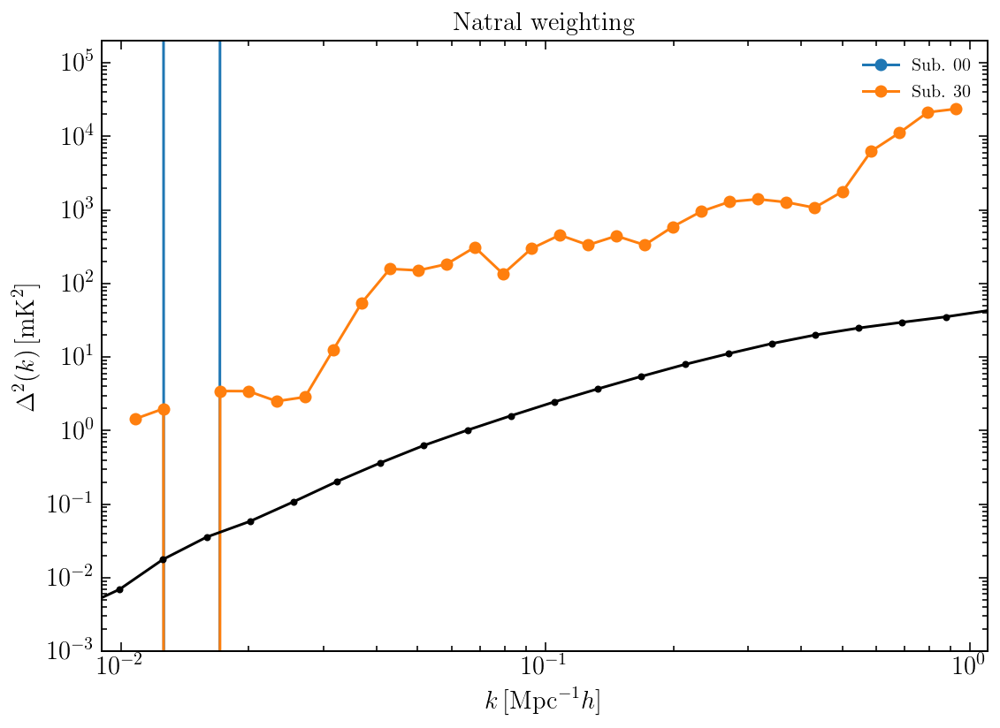

In [141]:
data_path = '/home/ycli/data/ska_challenge/oskar_sim/wsclean_output/'
file_name = 'imap00_HI_PS_FG_uw_multiscale'
suffix = 'image'
data_name = '%s_cube-%s.fits'%(file_name, suffix)
results_list = [data_path + '%s_fgps-%s.h5'%(file_name, suffix),]
label_list = ['Natral weighting',]

plot_ps(results_list, label_list, ymin=1.e-3, ymax=2.e5, xmin=9.e-3, xmax=1.1e0)

## test Jy2K

In [114]:
with fits.open(data_path + data_name_list[0]) as hlist:
    w = WCS(hlist[0].header)#.celestial
    w = w.dropaxis(3) # drop stokes axis
    bmaj = hlist[0].header['BMAJ'] * u.deg
    bmin = hlist[0].header['BMIN'] * u.deg
    freq0 = hlist[0].header['CRVAL3'] * u.Hz
    print(bmaj)
    omega_B = 2. * np.pi * bmaj * bmin
    equi =u.brightness_temperature(freq0)
    Jy2K = ( 1 * u.Jy/omega_B ).to(u.K, equivalencies=equi).value
    print(Jy2K)

0.0172732447937825 deg
5111.967878275629


In [116]:
with fits.open(data_path + data_name_list[0]) as hlist:
    w = WCS(hlist[0].header)#.celestial
    w = w.dropaxis(3) # drop stokes axis
    bmaj = hlist[0].header['BMAJ'] * u.deg
    bmin = hlist[0].header['BMIN'] * u.deg
    freq = hlist[0].header['CRVAL3'] * u.Hz
    print(bmaj)
    factor = 2 * np.sqrt(2 * np.log(2))
    omega_B = 2. * np.pi * bmaj / factor * bmin / factor
    equi =u.brightness_temperature(freq0)
    Jy2K_c = ( 1 * u.Jy/omega_B ).to(u.K, equivalencies=equi).value
    print(Jy2K_c)

0.0172732447937825 deg
28346.76897551806


In [35]:
hi_path = '/home/DATA/shaoyue/data_challenge_900/'
hi_name = 'lightcones_brightness_xy600_z900_r20230200.h5'
with h5.File(hi_path + hi_name, 'r') as fp:
    imap = al.load_h5(fp, 'delta_T')
    imap = al.make_vect(imap, axis_names=imap.info['axes'])
bmaj = imap.info['dec_delta'] * u.deg
bmin = imap.info['ra_delta'] * u.deg
omega_B = 2. * np.pi * bmaj * bmin
equi =u.brightness_temperature(freq)
Jy2K = ( 1 * u.Jy/omega_B ).to(u.K, equivalencies=equi).value
print(Jy2K)

6629.308419954155


In [118]:
with fits.open(data_path + data_name_list[0]) as hlist:
    w = WCS(hlist[0].header)#.celestial
    w = w.dropaxis(3) # drop stokes axis
    beam_area = hlist[0].header['BMAJ'] * hlist[0].header['BMIN']
    pixl_area = 0.0044 * 0.0044
    
    pixl_numb = beam_area / pixl_area
    
    
    bmaj = 0.0044 * u.deg
    bmin = 0.0044 * u.deg
    freq = hlist[0].header['CRVAL3'] * u.Hz
    print(bmaj)
    
    omega_B = 2. * np.pi * bmaj  * bmin 
    equi =u.brightness_temperature(freq0)
    Jy2K_ccc = ( 1 * u.Jy/omega_B ).to(u.K, equivalencies=equi).value
    Jy2K_ccc /= pixl_numb
    print(Jy2K_ccc)

0.0044 deg
5111.967878275628


In [117]:
print((Jy2K/Jy2K_c)**2)
print((Jy2K_c/Jy2K_cc)**2)

0.03252139032821263
0.1312301782614411


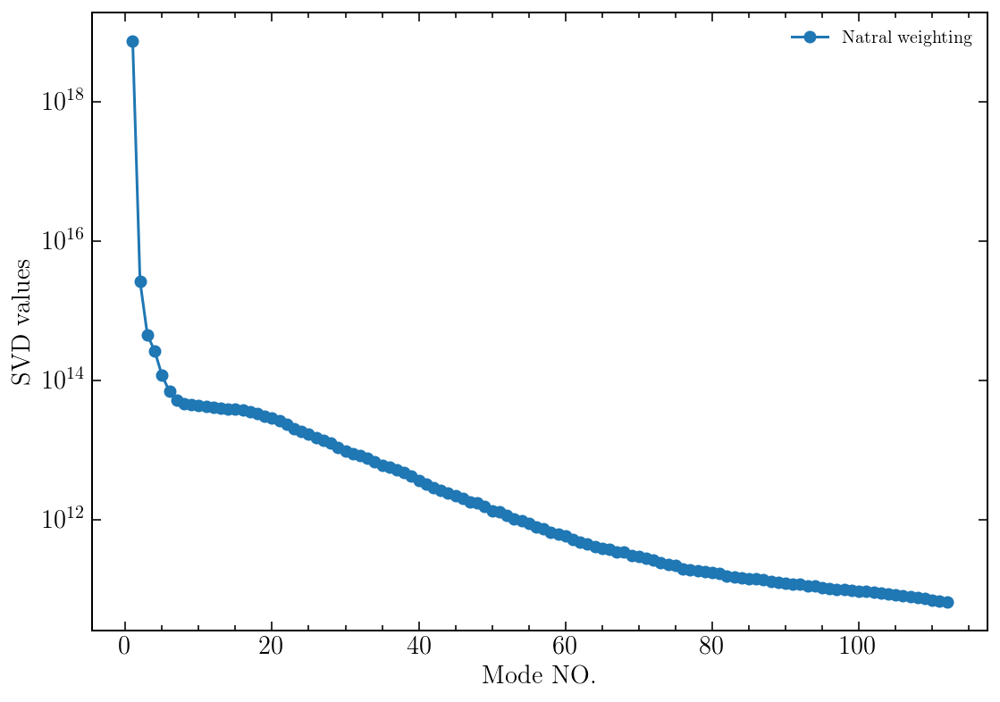

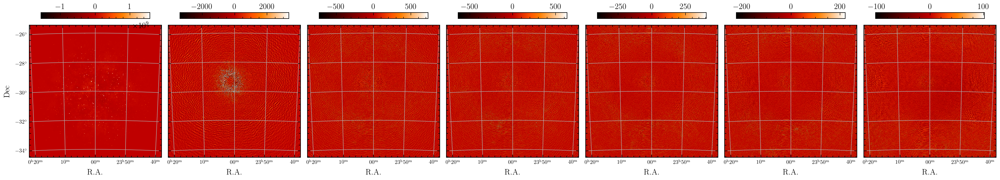

In [28]:
plot_svdvalue([result_image_ska_nw,], ['Natral weighting', ],)
plot_svdmaps(result_image_ska_nw)

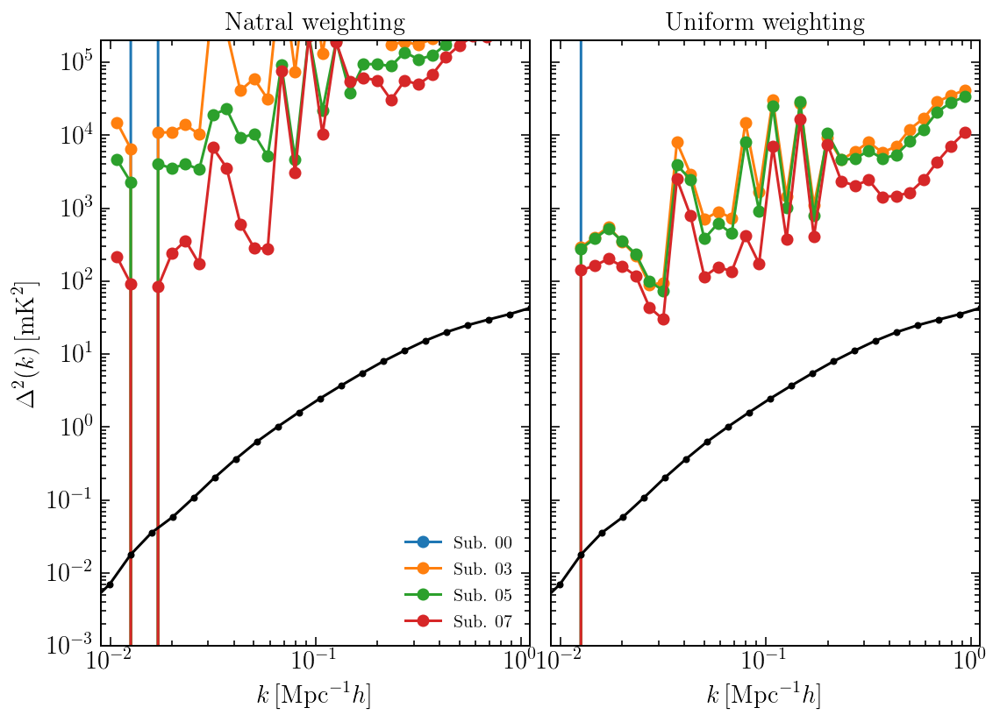

In [18]:
plot_ps([result_image_ska_uw_multiscale10, result_image_ska_uw_multiscale80], 
        ['Natral weighting', 'Uniform weighting'],
        mode_list =  [0, 3, 5, 7],
        ymin=1.e-3, ymax=2.e5, xmin=9.e-3, xmax=1.1e0)

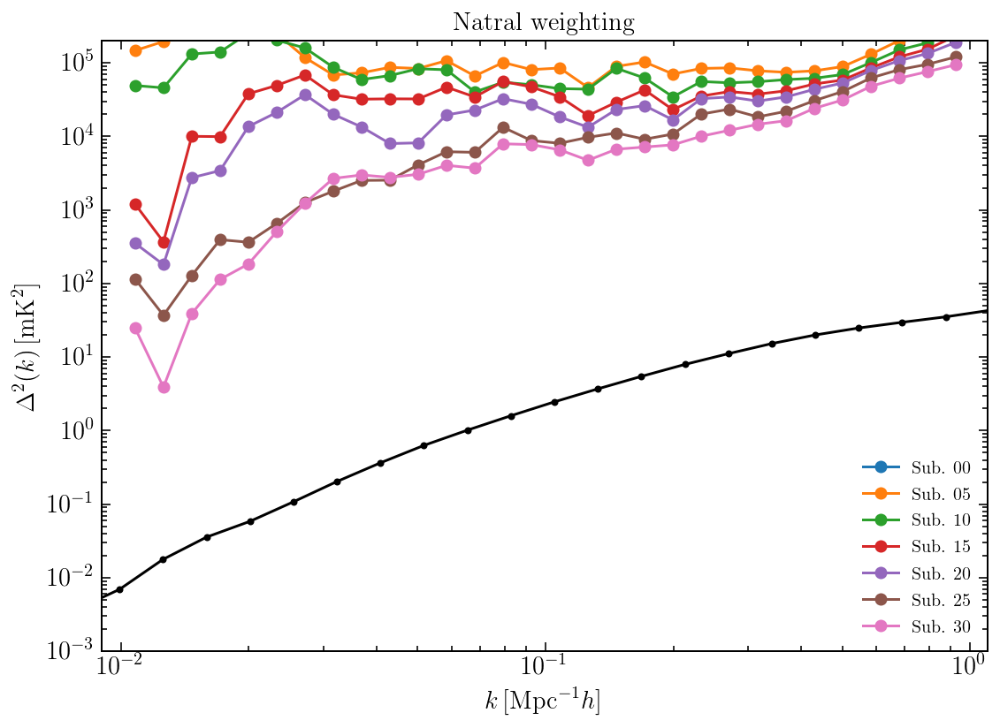

In [24]:
plot_ps([result_image_ska_uw_multiscale, ], 
        ['Natral weighting', 'Uniform weighting'],
        mode_list = [0, 5, 10, 15, 20, 25, 30],
        ymin=1.e-3, ymax=2.e5, xmin=9.e-3, xmax=1.1e0)

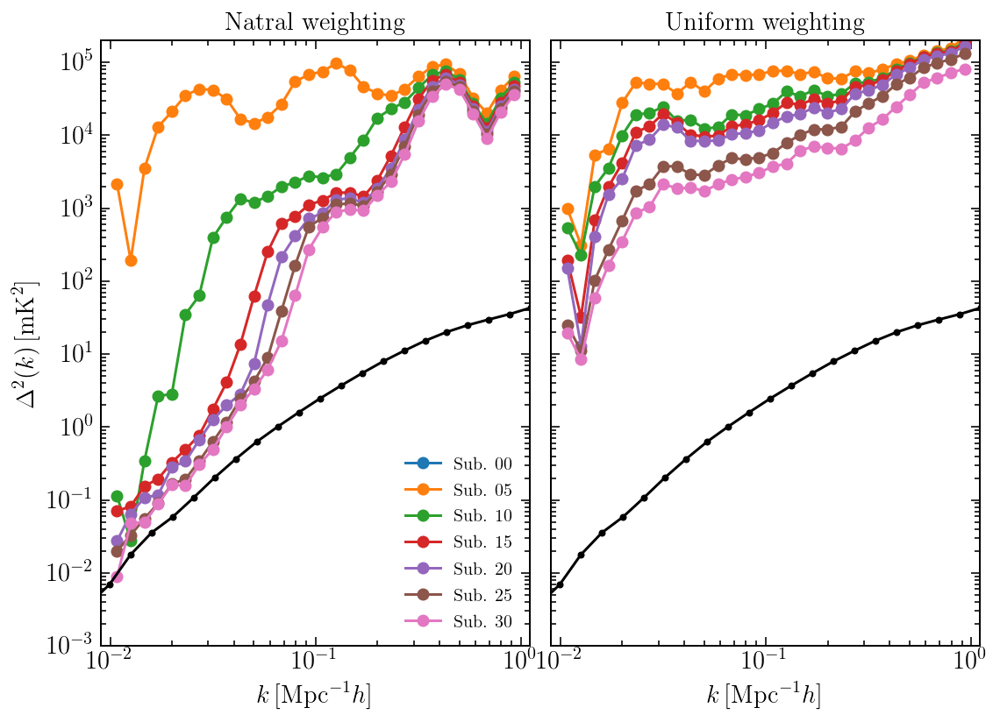

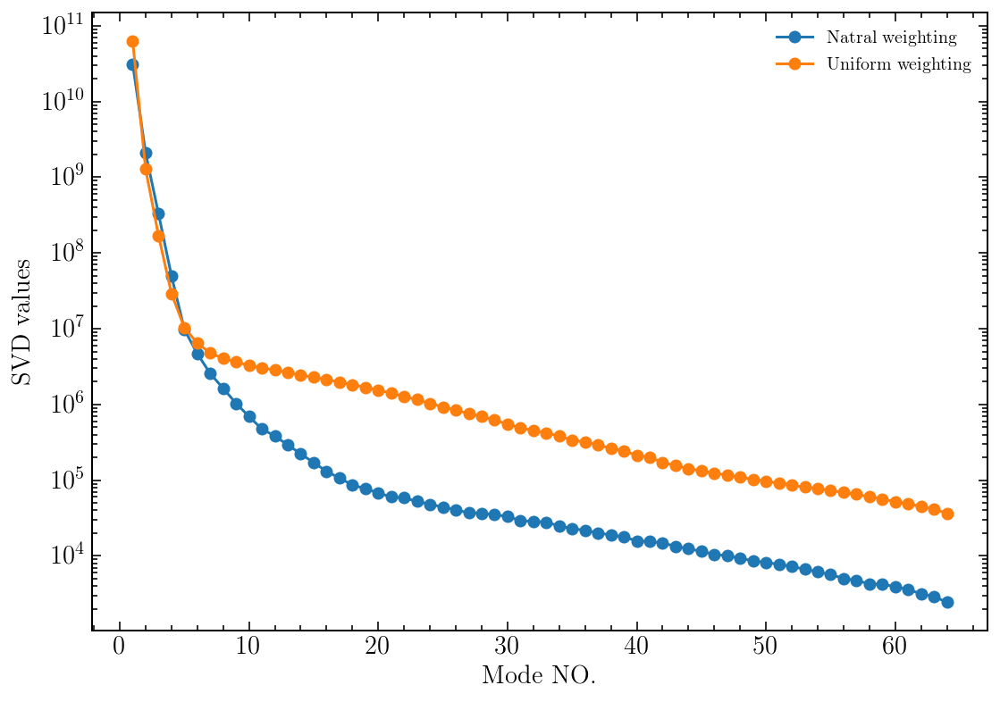

In [138]:
plot_ps([result_image_ska_nw, result_image_ska_uw], 
        ['Natral weighting', 'Uniform weighting'],
        mode_list = [0, 5, 10, 15, 20, 25, 30],
        ymin=1.e-3, ymax=2.e5, xmin=9.e-3, xmax=1.1e0)
plot_svdvalue([result_image_ska_nw, result_image_ska_uw], 
        ['Natral weighting', 'Uniform weighting'],)

In [133]:
data_path = '/home/ycli/data/ska_challenge/oskar_sim/wsclean_output/'
file_name = 'FG_HI_PSshuffle_00_nw'
data_name = '%s_cube-image.fits'%file_name
mode_list = [0, 5, 10, 15, 20, 25, 30]
result_image_ska_nw_mask = fgclean_and_psest(data_path, data_name, mode_list, mask_edges=256)

mask edges 256


/home/ycli/code/fpipe/fpipe/ps/find_modes.py:89: RuntimeWarning: invalid value encountered in true_divide
  amp /= sp.tensordot(mode_vector,


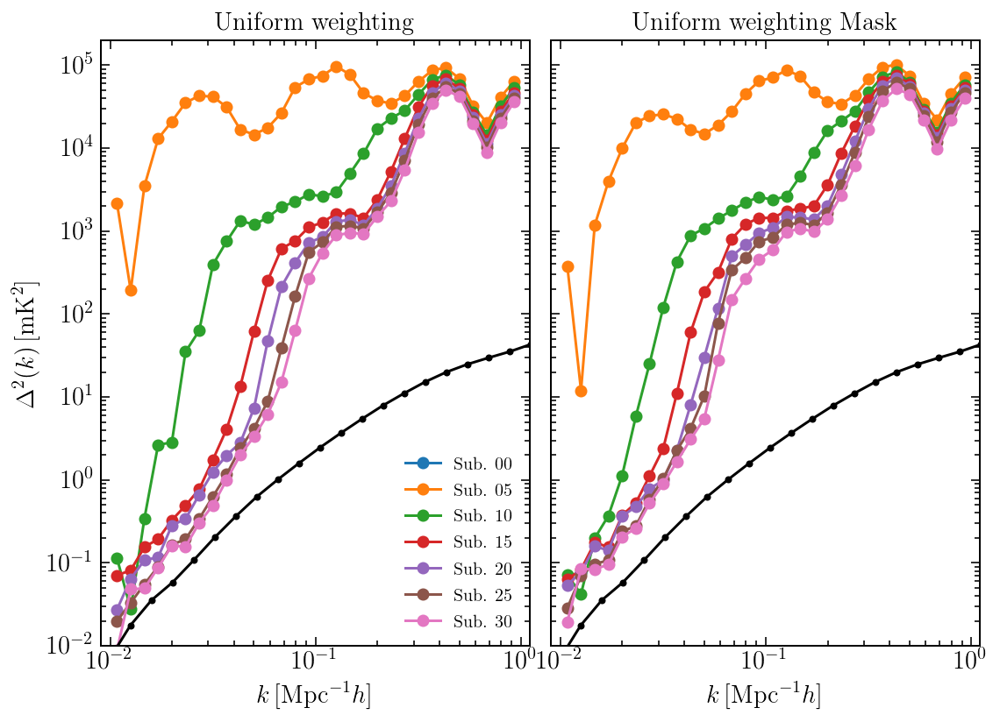

In [136]:
plot_ps([result_image_ska_nw, result_image_ska_nw_mask], 
        ['Uniform weighting', 'Uniform weighting Mask'],
        mode_list = [0, 5, 10, 15, 20, 25, 30],
        ymin=1.e-2, ymax=2.e5, xmin=9.e-3, xmax=1.1e0)

In [10]:
data_path = '/home/ycli/data/ska_challenge/oskar_sim/wsclean_output/'
data_name = '%s_test_cube-image.fits'%file_name
mode_list = [0, 5, 10, 15, 20, 25, 30]
result_image_test = fgclean_and_psest(data_path, data_name, mode_list)

In [11]:
data_path = '/home/ycli/data/ska_challenge/oskar_sim/wsclean_output/'
data_name = '%s_test_cube-dirty.fits'%file_name
result_dirty_test = fgclean_and_psest(data_path, data_name, mode_list)

In [36]:
result_path = '/home/DATA/ycli/ska_challenge/2023/ps_results/'
result_name = 'lightcones_brightness_xy600_z90.h5'
with h5.File(result_path + result_name, 'r') as fp:
    print(fp.keys())
    eor_kbin = fp['kbin'][:]
    eor_ps1d = fp['ps1d'][:]

<KeysViewHDF5 ['kbin', 'kbin_x', 'kbin_x_edge', 'kbin_y', 'kbin_y_edge', 'ps1d', 'ps2d']>


In [38]:
print(eor_ps1d.shape)

(100, 25)


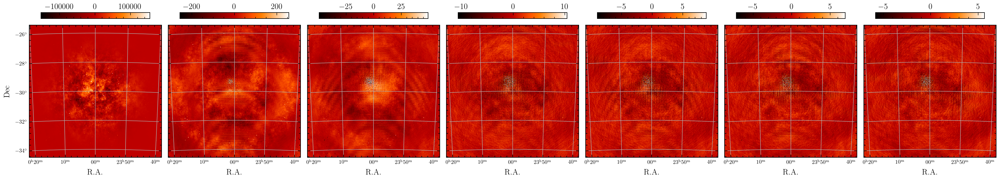

In [57]:
plot_svdmaps(result_image_ska_uw_multiscale)

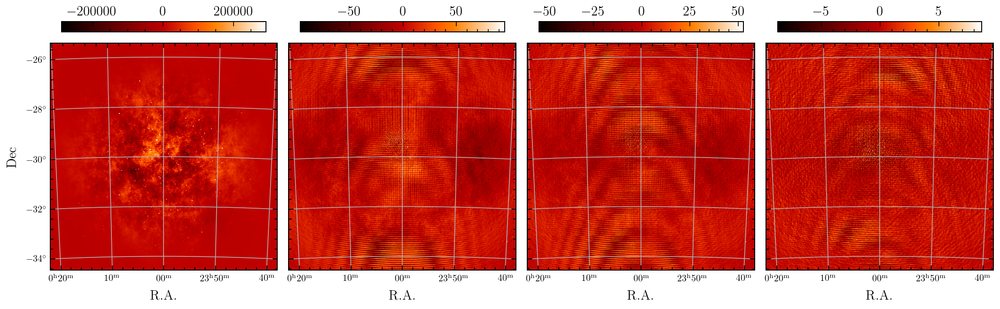

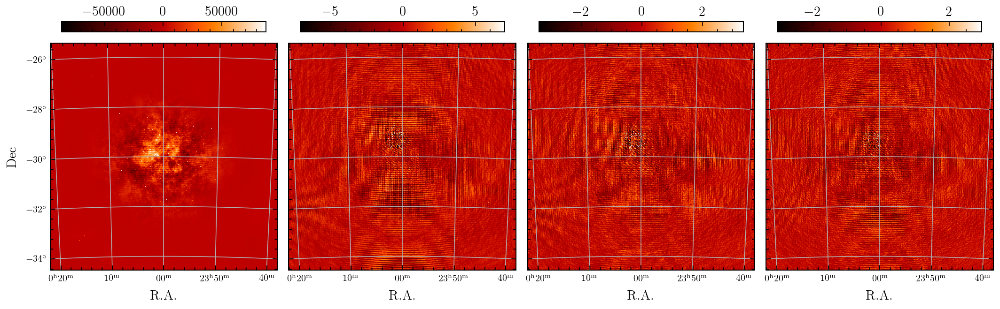

In [22]:
plot_svdmaps(result_image_ska_uw_multiscale10, figsize=(17, 5))
plot_svdmaps(result_image_ska_uw_multiscale80, figsize=(17, 5))

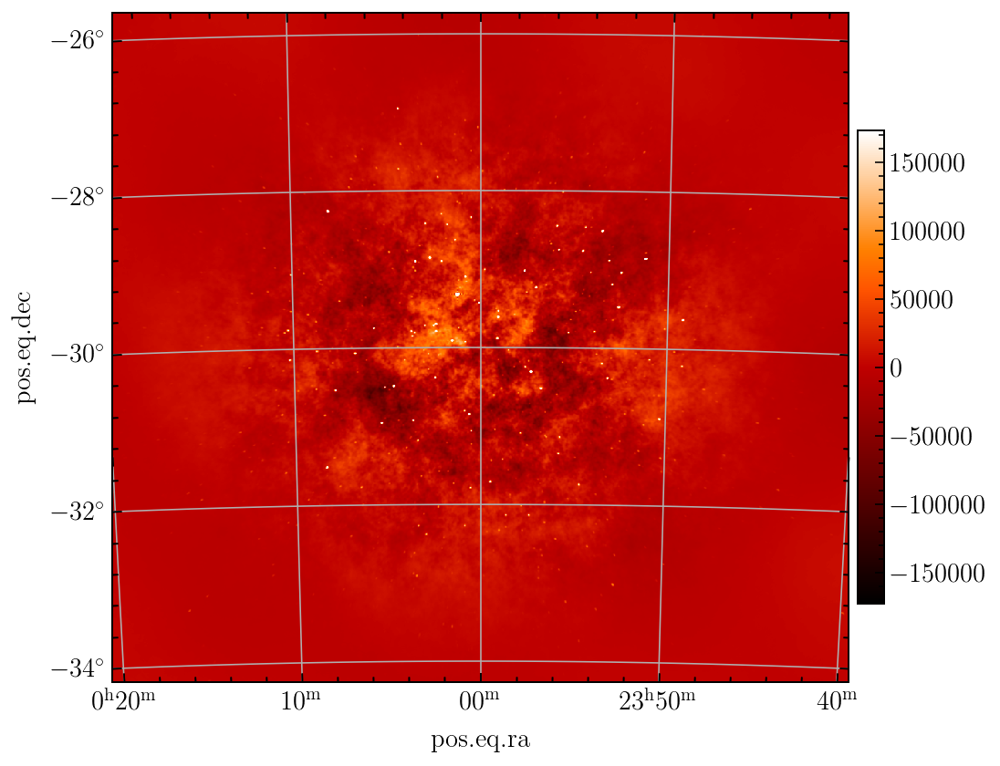

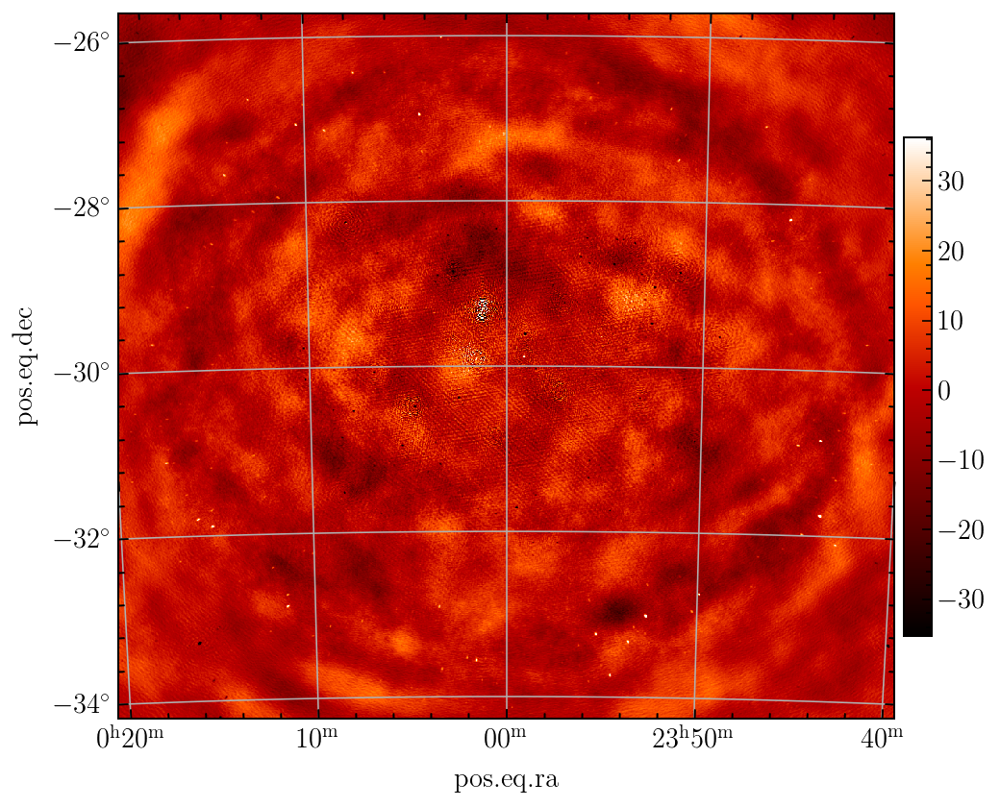

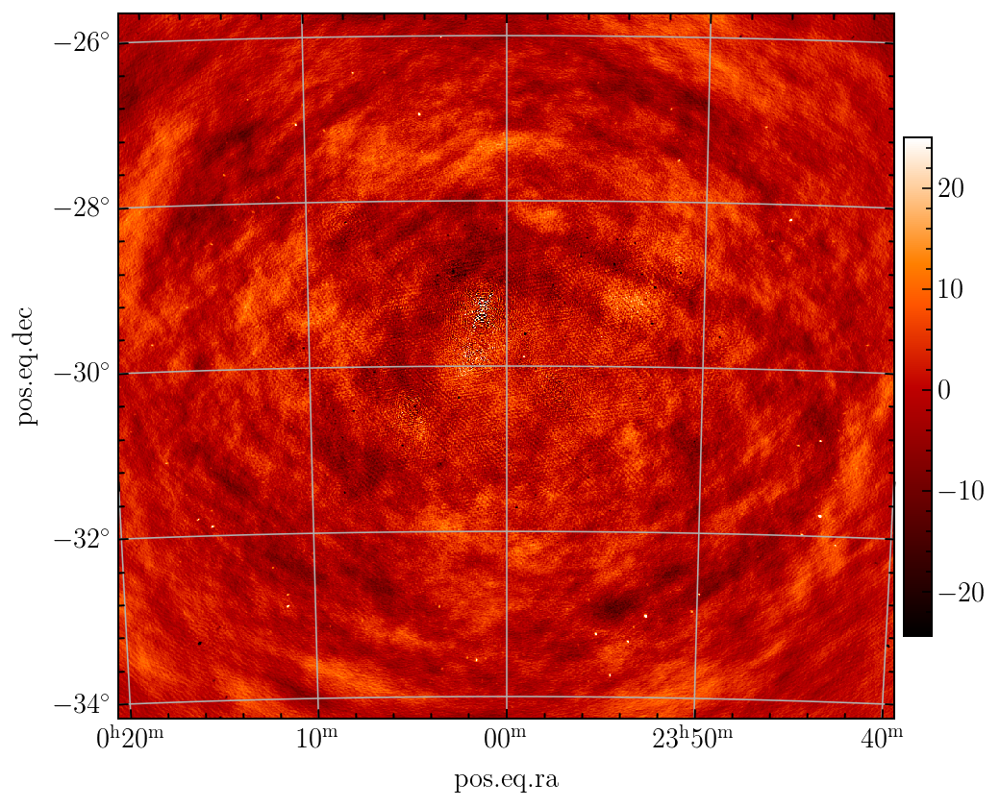

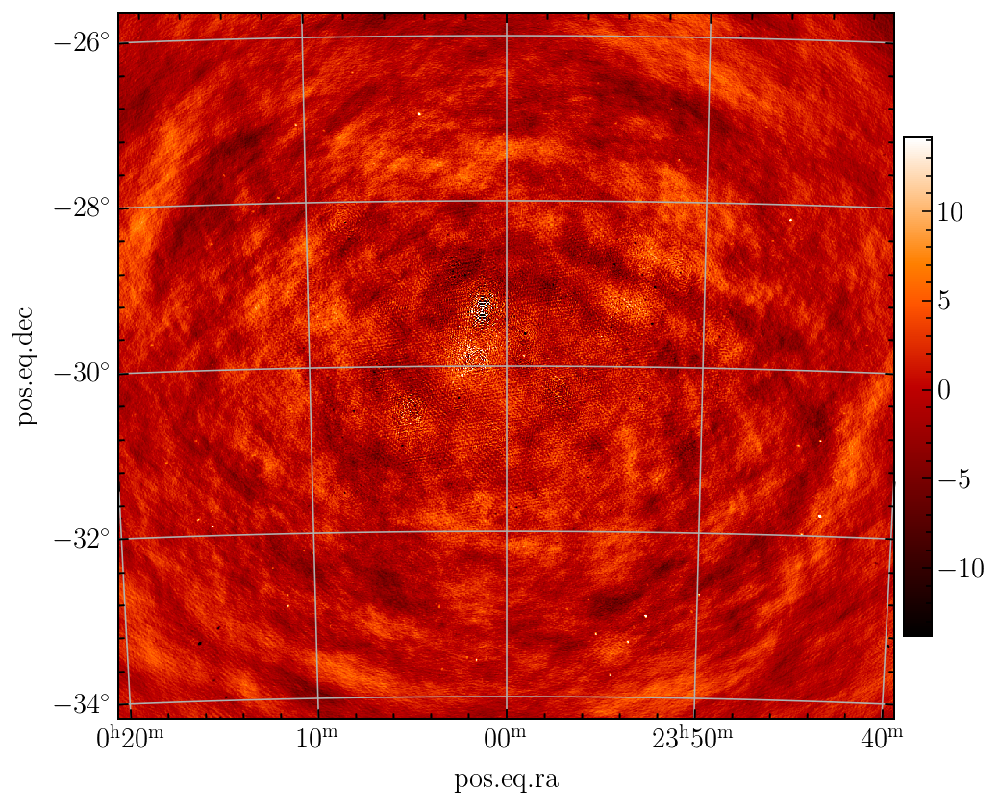

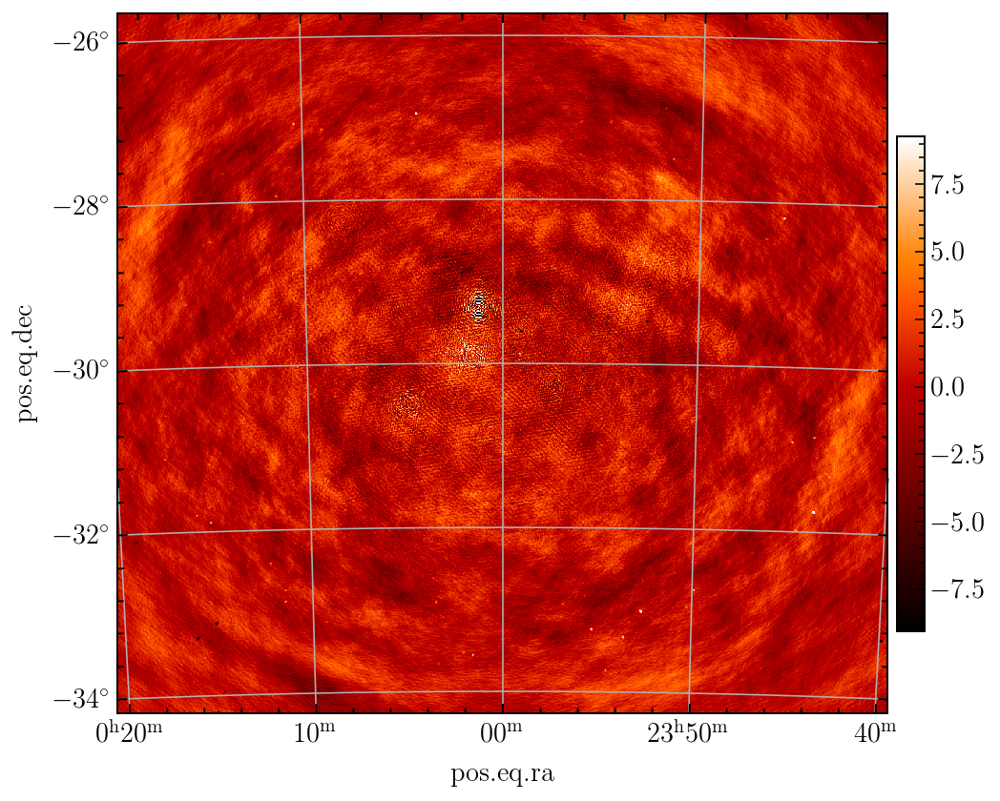

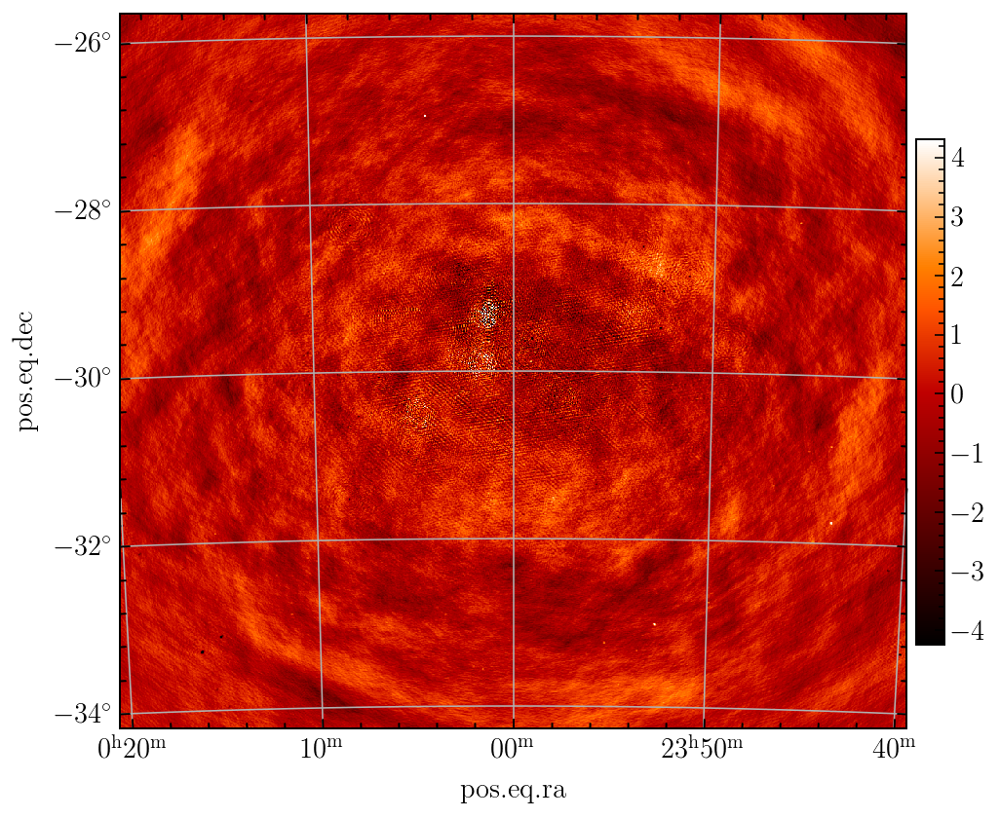

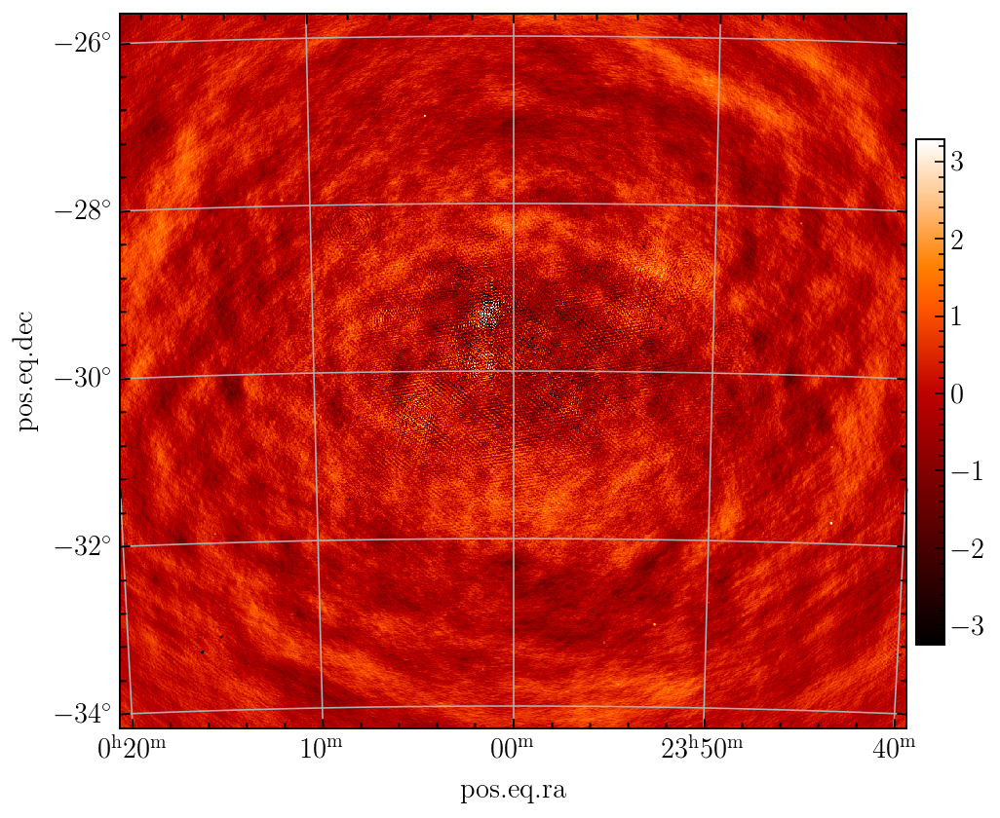

In [91]:
for i, d in enumerate(data_cleaned_image_ska_uw):
    
    factor = 1.

    slices = [0, ] * w.naxis
    slices[0] = 'x'
    slices[1] = 'y'
    
    figsize = (7, 6)
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0.1, 0.1, 0.80, 0.85], projection=w, slices=tuple(slices))
    cax = fig.add_axes([0.91, 0.2, 0.2/float(figsize[0]), 0.6])
    
    d = np.ma.masked_equal(d, 0)
    mean = np.ma.mean(d)
    std  = np.ma.std(np.ma.mean(d, axis=0))
    vmin = mean - 6 * std
    vmax = mean + 6 * std

    im = ax.pcolormesh(np.ma.mean(d, axis=0) * factor, 
                       vmin=vmin, vmax=vmax, cmap='gist_heat')
    fig.colorbar(im, ax=ax, cax=cax)

In [25]:
for i, d in enumerate(result_image_ska_uw_multiscale):
    
    factor = 1.

    slices = [0, ] * w.naxis
    slices[0] = 'x'
    slices[1] = 'y'
    
    figsize = (7, 6)
    fig = plt.figure(figsize=figsize)
    ax = fig.add_axes([0.1, 0.1, 0.80, 0.85], projection=w, slices=tuple(slices))
    cax = fig.add_axes([0.91, 0.2, 0.2/float(figsize[0]), 0.6])
    
    d = np.ma.masked_equal(d, 0)
    mean = np.ma.mean(d)
    std  = np.ma.std(np.ma.mean(d, axis=0))
    vmin = mean - 6 * std
    vmax = mean + 6 * std

    im = ax.pcolormesh(np.ma.mean(d, axis=0) * factor, 
                       vmin=vmin, vmax=vmax, cmap='gist_heat')
    fig.colorbar(im, ax=ax, cax=cax)

NameError: name 'w' is not defined

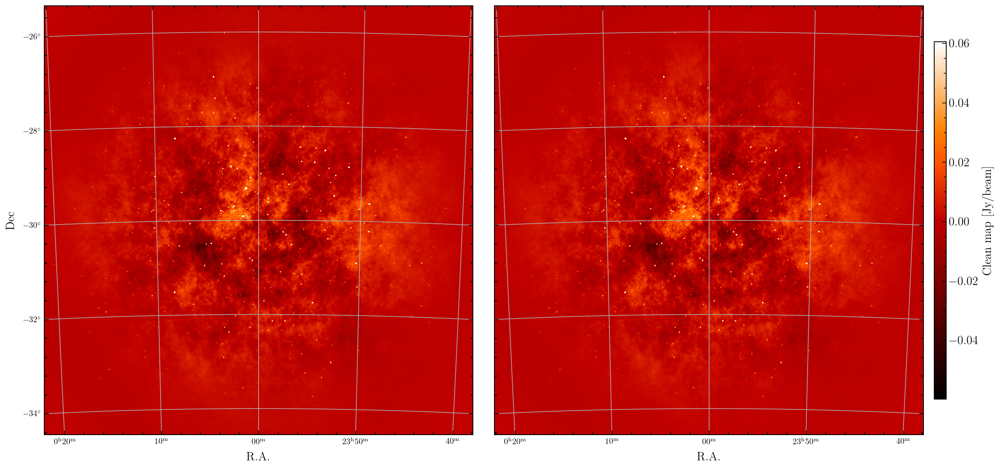

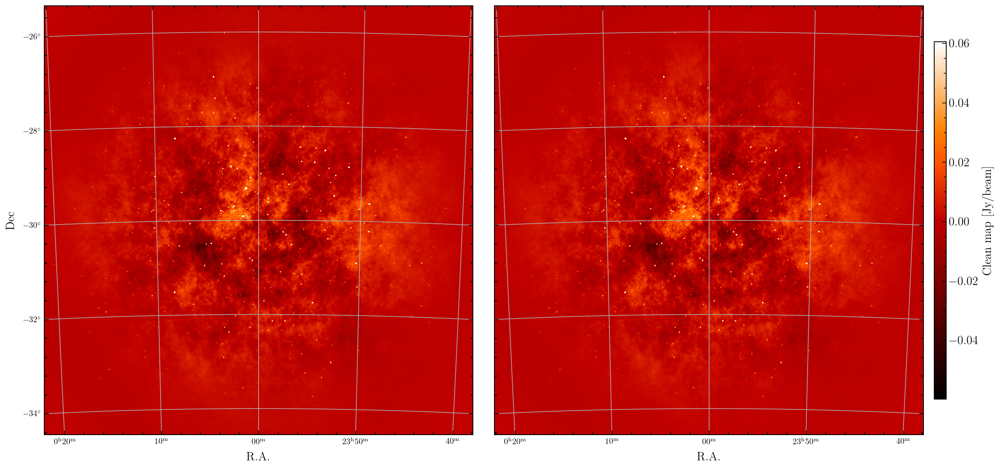

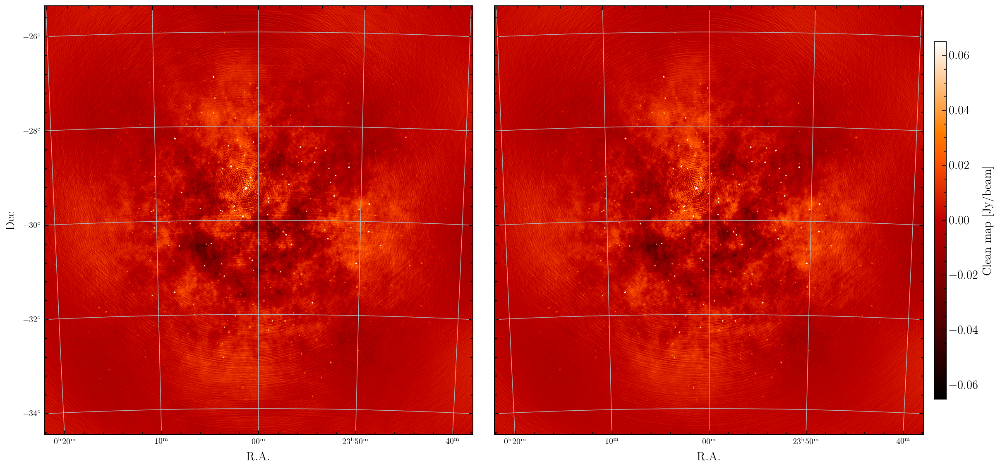

In [10]:
data_path = '/home/DATA/ycli/ska_challenge/oskar_sim/wsclean_output/'
file_name = 'FG_HI_PSshuffle_00_uw_multiscale'
#data_name_list = ['%s_test/%sFreq%d.49MHz-image.fits'%(file_name, file_name, i) for i in range(105, 158, 4) ]
#data_name_list = ['%s/Freq%d.49MHz-image.fits'%(file_name, i) for i in range(105, 158, 4) ]
#show_map_multifreq(data_path, data_name_list, sigma=10, figsize=(8, 8), n_col=4, label='Clean map [Jy/beam]')

#data_name_list = ['%s/Freq%d.49MHz-image.fits'%(file_name, i) for i in range(105, 107, 1) ]
#show_map_multifreq(data_path, data_name_list, sigma=6, figsize=(18, 10), n_col=2, label='Clean map [Jy/beam]')

data_name_list = ['%s/Freq%d.49MHz-image.fits'%(file_name, i) for i in range(105, 107, 1) ]
show_map_multifreq(data_path, data_name_list, sigma=6, figsize=(18, 10), n_col=2, label='Clean map [Jy/beam]')

data_name_list = ['%s/Freq%d.49MHz-dirty.fits'%(file_name, i) for i in range(105, 107, 1) ]
show_map_multifreq(data_path, data_name_list, sigma=6, figsize=(18, 10), n_col=2, label='Clean map [Jy/beam]')

In [ ]:
data_path = '/home/ycli/code/wsclean_script/output/cube/'
file_name = 'FG_HI_PSshuffle_00'
data_name_list = ['%sFreq%d.49MHz-dirty.fits'%(file_name, i) for i in range(105, 169, 4) ]
show_map_multifreq(data_path, data_name_list, sigma=10, figsize=(8, 8), n_col=4, label='Dirty map [Jy/beam]')

In [118]:
data_path = '/home/ycli/data/ska_challenge/oskar_sim/wsclean_output/'
file_name = 'FG_HI_PSshuffle_00'
data_name = '%s/%sFreq105.49MHz-image.fits'%(file_name, file_name)
with fits.open(data_path + data_name) as hlist:
    display(hlist[0].header)
    bmaj = hlist[0].header['BMAJ']
    bmin = hlist[0].header['BMIN']
    

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                  -32 / number of bits per data pixel                  
NAXIS   =                    4 / number of data axes                            
NAXIS1  =                 1024 / length of data axis 1                          
NAXIS2  =                 1024 / length of data axis 2                          
NAXIS3  =                    1 / length of data axis 3                          
NAXIS4  =                    1 / length of data axis 4                          
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
BSCALE  =                   1.                                                  
BZERO   =                   0.                                                  
BUNIT   = 'JY/BEAM '        

In [158]:
data_path = '/home/ycli/data/ska_challenge/2023/Images/'
data_name = 'ZW2.msw_image.fits'
with fits.open(data_path + data_name) as hlist:
    display(hlist[0].header)

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                  -32 / number of bits per data pixel                  
NAXIS   =                    3 / number of data axes                            
NAXIS1  =                 2048 / length of data axis 1                          
NAXIS2  =                 2048 / length of data axis 2                          
NAXIS3  =                  901 / length of data axis 3                          
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
BSCALE  =                   1.                                                  
BZERO   =                   0.                                                  
BUNIT   = 'JY/BEAM '           / Units are in Jansky per beam                   
BMAJ    =   0.01724196054110

In [137]:
data_path = '/home/ycli/data/ska_challenge/2023/Images/'
data_name = 'ZW2.msn_image.fits'
with fits.open(data_path + data_name) as hlist:
    display(hlist[0].header)

SIMPLE  =                    T / file does conform to FITS standard             
BITPIX  =                  -32 / number of bits per data pixel                  
NAXIS   =                    3 / number of data axes                            
NAXIS1  =                 2048 / length of data axis 1                          
NAXIS2  =                 2048 / length of data axis 2                          
NAXIS3  =                  901 / length of data axis 3                          
EXTEND  =                    T / FITS dataset may contain extensions            
COMMENT   FITS (Flexible Image Transport System) format is defined in 'Astronomy
COMMENT   and Astrophysics', volume 376, page 359; bibcode: 2001A&A...376..359H 
BSCALE  =                   1.                                                  
BZERO   =                   0.                                                  
BUNIT   = 'JY/BEAM '           / Units are in Jansky per beam                   
BMAJ    =   0.05536079130322

In [182]:
def ps_est_for_testdset(test_path, test_data):
    
    with fits.open(test_path + test_data) as hlist:
        #print(hlist[0].header)
        w = WCS(hlist[0].header)
        data = hlist[0].data
        spec = w.spectral
        bmaj = hlist[0].header['BMAJ'] * u.deg
        bmin = hlist[0].header['BMIN'] * u.deg
        freq = spec.all_pix2world(np.arange(data.shape[0]), 0)[0] * u.Hz
        
        omega_B = 2. * np.pi * bmaj * bmin
        equi =u.brightness_temperature(freq)
        Jy2K = ( 1 * u.Jy/omega_B ).to(u.K, equivalencies=equi).value
        
        data = data * Jy2K[:, None, None] * 1.e3

    ps2d_test, ps1d_test = ps_est(data, w, weight=None, window='blackman', 
           kmin = 0.01, kmax = 1.00, knum = 30, logk = True,
           kmin_x = 0.02, kmax_x = 0.40, knum_x = 40, 
           kmin_y = 0.04, kmax_y = 0.90, knum_y = 20, 
           logk_2d = True, unitless=True)
    result_test_nw = {}
    result_test_nw['ps2d'] = [ps2d_test,]
    result_test_nw['ps1d'] = [ps1d_test,]
    
    return result_test_nw

In [183]:
test_path = '/home/DATA/ycli/ska_challenge/2023/TestDataset/'
test_data = 'TestDataset.msn_image.fits'
result_test_nw = ps_est_for_testdset(test_path, test_data)

In [189]:
test_path = '/home/DATA/ycli/ska_challenge/2023/TestDataset/'
test_data = 'TestDataset.msw_image.fits'
result_test_uw = ps_est_for_testdset(test_path, test_data)

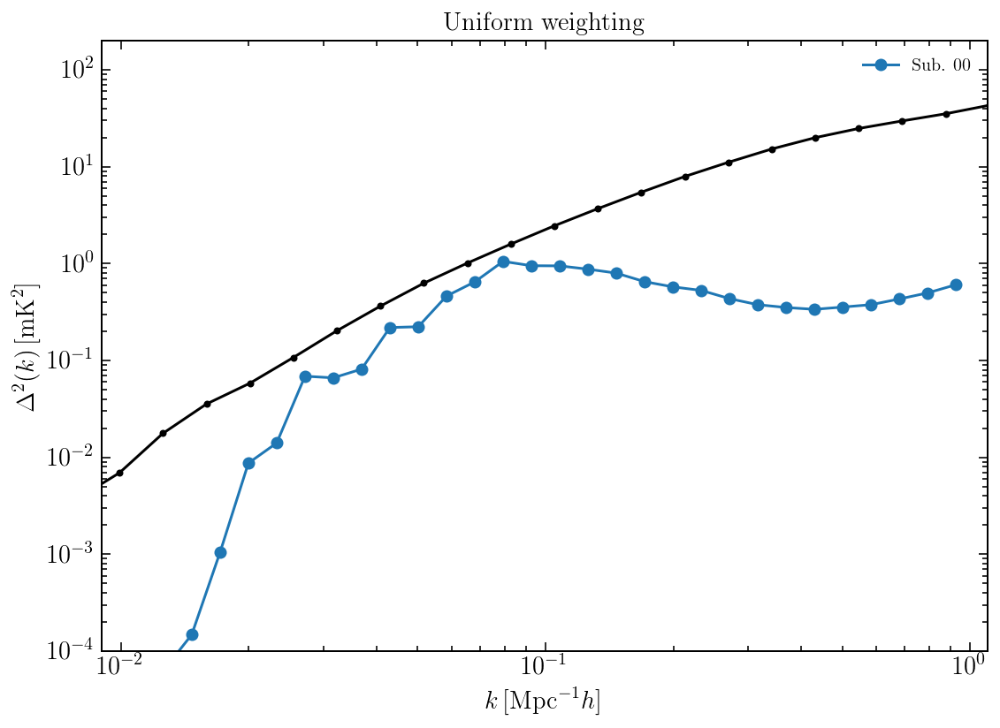

In [188]:
plot_ps([result_test_nw, ], 
        ['Uniform weighting', 'Uniform weighting Mask'],
        mode_list = [0, ],
        ymin=1.e-4, ymax=2.e2, 
        #ymin=1.e-16, ymax=1.e-11, 
        xmin=9.e-3, xmax=1.1e0)